## Import Libraries

In [3]:
# Set seed for reproducibility
seed = 42

!pip install -q --upgrade tensorflow==2.17.0
!pip install -q --upgrade keras==3.4.1
!pip install -q --upgrade keras-cv
!pip install -q --upgrade imblearn

# Import necessary libraries
import os

# Set environment variables before importing modules
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
os.environ['PYTHONHASHSEED'] = str(seed)
os.environ['MPLCONFIGDIR'] = os.getcwd() + '/configs/'

# Suppress warnings
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=Warning)

# Import necessary modules
import logging
import random
import numpy as np

# Set seeds for random number generators in NumPy and Python
np.random.seed(seed)
random.seed(seed)

# Import TensorFlow and Keras
import tensorflow as tf
import keras as tfk
from keras import layers as tfkl
from tensorflow.keras import mixed_precision

# Set seed for TensorFlow
tf.random.set_seed(seed)
tf.compat.v1.set_random_seed(seed)

# Reduce TensorFlow verbosity
tf.autograph.set_verbosity(0)
tf.get_logger().setLevel(logging.ERROR)
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)

# setting mixed precision
#mixed_precision.set_global_policy('mixed_float16')

# Import other libraries
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score
from sklearn.utils import class_weight
import seaborn as sns
from PIL import Image
import matplotlib.gridspec as gridspec

# Configure plot display settings
sns.set(font_scale=1.4)
sns.set_style('white')
plt.rc('font', size=14)
%matplotlib inline

import keras_cv
import hashlib
from collections import defaultdict
import matplotlib.pyplot as plt

AUTOTUNE = tf.data.AUTOTUNE

print(f"Tensorflow version -> {tf.__version__}")
print(f"Keras version -> {tfk.__version__}")


Tensorflow version -> 2.17.0
Keras version -> 3.4.1


## Load the Data

In [4]:
# Loading data from training_set.npz
data = np.load('/kaggle/input/training/training_set.npz') 

X_data = data['images']
y_data = data['labels']

# labeling data
labels = {0:'Basophil', 1:'Eosinophil', 2:'Erythroblast', 3:'Immature granulocytes', 4:'Lymphocyte', 5:'Monocyte', 6:'Neutrophil', 7:'Platelet'}

print("Dataset dimension: ", X_data.shape[0])

Dataset dimension:  13759


## Inspect Data

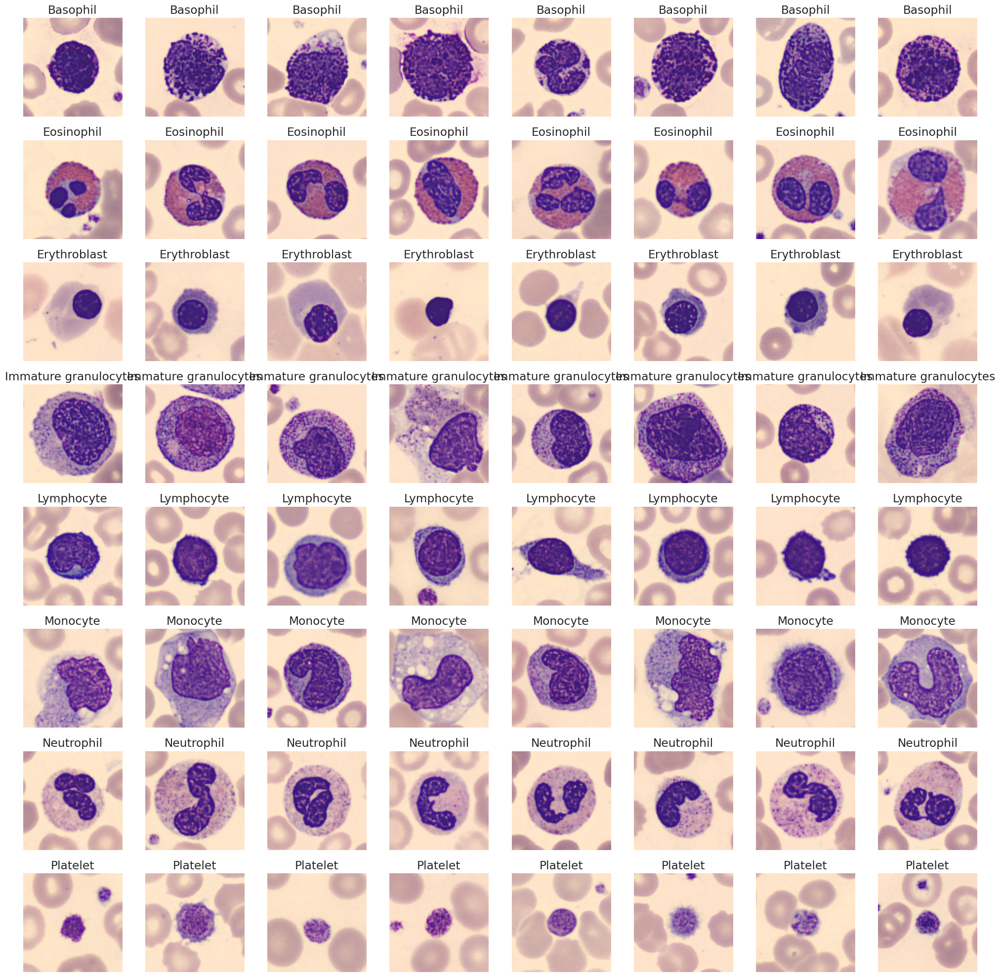

In [9]:
# counting the number of items per class
def countClasses(y_data = y_data):
    data_info = {}
    for i in range(len(y_data)):
      if data_info.get(y_data[i][0]) is None:
        data_info[y_data[i][0]] = 1
      else:
        data_info[y_data[i][0]] += 1
    return data_info

# displaying 8 images per class
def print_dataset(
    labels = labels,
    X_data = X_data,
    y_data = y_data
):
    num_img = len(labels)
    fig, axes = plt.subplots(num_img, num_img, figsize=(20, 20)) #(1,...)
    
    for i in range(num_img):
      count = 0 #remove
      for j in range(len(X_data)):
        if y_data[j] == i:
          ax = axes[i, count] #i
          ax.imshow(np.squeeze(X_data[j]), vmin=0., vmax=1.)
          ax.set_title(f'{labels[y_data[j][0]]}')
          ax.axis('off')
          count += 1 #remove
          if count == num_img: #remove
            break
    
    # Adjust layout and display the images
    plt.tight_layout()
    plt.show()

print_dataset()

Duplicate images found!


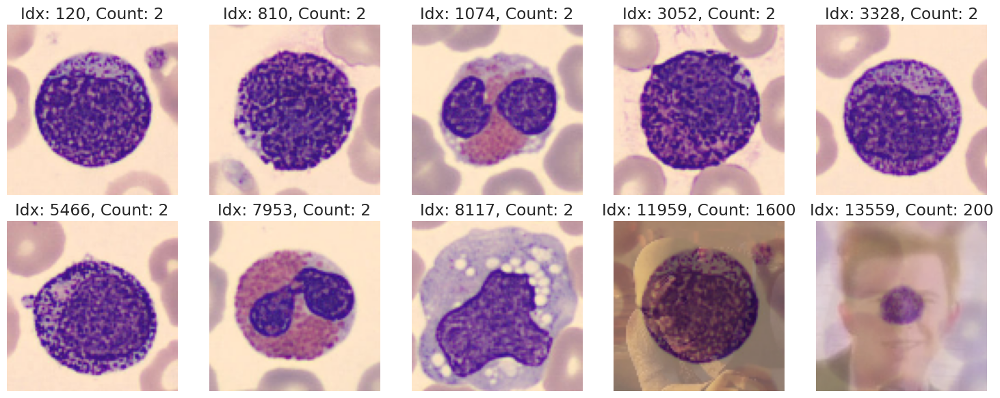

In [5]:
# search for duplicates

# Function to calculate the hash of an image
def calculate_image_hash(image):
    return hashlib.md5(image.tobytes()).hexdigest()

# Calculate hashes for each image and store their indices
hash_dict = defaultdict(list)
for idx, image in enumerate(X_data):
    img_hash = calculate_image_hash(image)
    hash_dict[img_hash].append(idx)

# Find duplicates
duplicates = {key: indices for key, indices in hash_dict.items() if len(indices) > 1}

if duplicates:
    print("Duplicate images found!")
    
   
    num_duplicates = len(duplicates)
    cols = 5 
    rows = (num_duplicates + cols - 1) // cols  
    
    # Create the figure and subplots
    fig, axes = plt.subplots(rows, cols, figsize=(15, 3 * rows))
    axes = axes.flatten()  
    
    for i, (img_hash, indices) in enumerate(duplicates.items()):
        # Select one representative image
        representative_idx = indices[0]
        occurrence_count = len(indices)  
        ax = axes[i]
        
        # Plot the image
        if X_data[representative_idx].ndim == 3: 
            ax.imshow(X_data[representative_idx])
        else: 
            ax.imshow(X_data[representative_idx], cmap='gray')
        
        # Set title with hash, occurrences, and first index
        ax.set_title(f"Idx: {representative_idx}, Count: {occurrence_count}")
        ax.axis('off')
    
    # Hide any unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')
    
    plt.tight_layout()
    plt.show()

else:
    print("No duplicate images found!")

In [6]:
# remove outliers

reference_image_shrek = X_data[11959]
reference_image_rickroll = X_data[13559]

#remove all the outliers
outliers_indices = [i for i in range(len(X_data)) if np.array_equal(X_data[i], reference_image_shrek)
                                                           or np.array_equal(X_data[i], reference_image_rickroll)]
X_data = np.delete(X_data, outliers_indices, axis=0)
y_data = np.delete(y_data, outliers_indices, axis=0)

print("Dataset dimension after deleting outliers: ", X_data.shape[0])

Dataset dimension after deleting outliers:  11959


In [7]:
# remove any other duplicate

#remove any further occurrences of duplicated images after the first one
unique_indices = {indices[0] for indices in hash_dict.values()} 
duplicate_indices_to_remove = set(range(len(X_data))) - unique_indices

X_data = np.delete(X_data, list(duplicate_indices_to_remove), axis=0)
y_data = np.delete(y_data, list(duplicate_indices_to_remove), axis=0)

print("Dataset dimension after deleting duplicated occurences: ", X_data.shape[0])

Dataset dimension after deleting duplicated occurences:  11951


In [10]:
data_info = countClasses()

# showing data information
print(f'X_data shape: {X_data.shape}')
print(f'y_data shape: {y_data.shape}\n')

print(f'Number of images per class')
for i in range(len(labels)):
  print(f'{labels[i]}: {data_info[i]}')

X_data shape: (11951, 96, 96, 3)
y_data shape: (11951, 1)

Number of images per class
Basophil: 850
Eosinophil: 2179
Erythroblast: 1085
Immature granulocytes: 2023
Lymphocyte: 849
Monocyte: 992
Neutrophil: 2330
Platelet: 1643


## Split dataset into train and validation set

In [11]:
# splitting the dataset into training, validation and test
X_train_val, X_test, y_train_val, y_test = train_test_split(X_data,y_data,random_state=seed,test_size=0.2,stratify=y_data)

# Further split the combined training and validation set into a training set and a validation set
X_train, X_val, y_train, y_val = train_test_split(X_train_val,y_train_val,test_size=0.2,random_state=seed,stratify=y_train_val)

# Print the shapes of the resulting sets
print('Training set shape:\nimages:', X_train.shape,'\tlabels:', y_train.shape)
print('Validation set shape:\nimages:', X_val.shape,'\tlabels:', y_val.shape)
print('Test set shape:\nimages:', X_test.shape,'\tlabels:',y_test.shape)


Training set shape:
images: (7648, 96, 96, 3) 	labels: (7648, 1)
Validation set shape:
images: (1912, 96, 96, 3) 	labels: (1912, 1)
Test set shape:
images: (2391, 96, 96, 3) 	labels: (2391, 1)


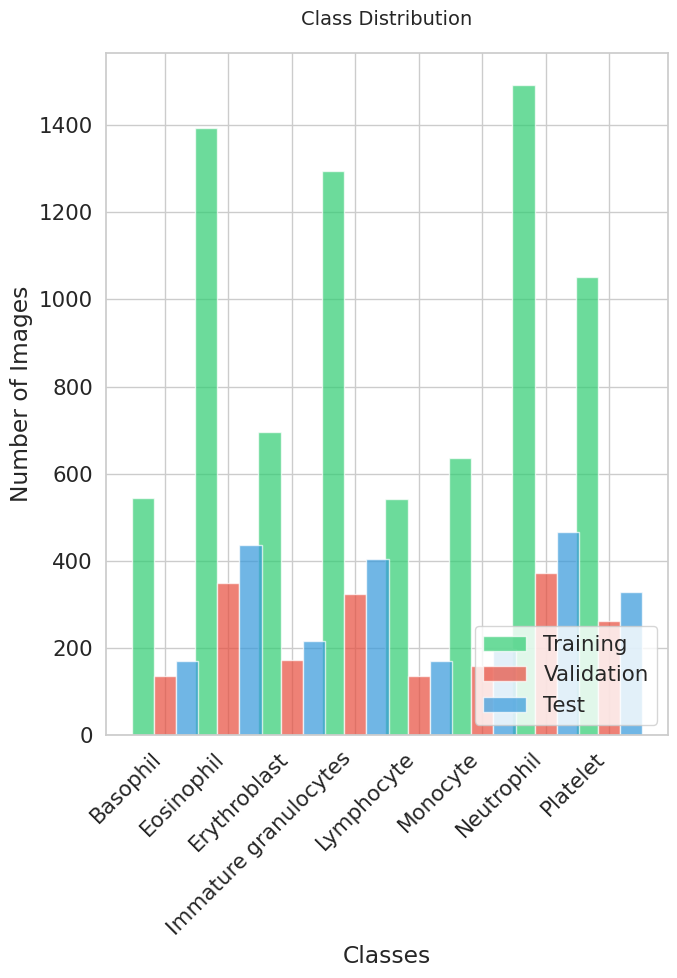

In [14]:
# showing classes distribution in the training, validation and test set

# Set seaborn style for the plot
sns.set_style("whitegrid")
plt.figure(figsize=(7, 10))

# Calculate class distributions for training and test sets
train_dist = np.bincount(y_train.flatten())
val_dist = np.bincount(y_val.flatten())
test_dist = np.bincount(y_test.flatten())

# Create x positions and set bar width
class_names = labels.values()
x = np.arange(len(class_names))
width = 0.35

# Plot bars for training and test distributions
plt.bar(x - width, train_dist, width, label='Training', color='#2ecc71', alpha=0.7)
plt.bar(x, val_dist, width, label='Validation', color='#e74c3c', alpha=0.7)
plt.bar(x + width, test_dist, width, label='Test', color='#3498db', alpha=0.7)

# Customise plot title and labels
plt.title('Class Distribution', pad=20, fontsize=14)
plt.xlabel('Classes')
plt.ylabel('Number of Images')

# Set class names as x-axis labels with rotation
plt.xticks(x, class_names, rotation=45, ha='right')

# Add legend for training and test distributions
plt.legend(loc='lower right')

# Adjust layout for optimal spacing
plt.tight_layout()
plt.show()

## Process Data

In [10]:
def augmentation(X,y):
    
    # augmix
    value_range = [0,1]
    chain_depth = [4,5]
    severity = random.uniform(0.7,0.9)
    num_chains = random.randint(3,4)
    alpha = 1.0
    augmix = keras_cv.layers.AugMix(value_range,severity,num_chains,chain_depth,alpha)
    
    # randaugm
    value_range = [0,1]
    augmentations_per_image = 4 
    magnitude = 0.6
    magnitude_stddev = 0.2
    rate = 0.9
    geometric=True
    
    layers = keras_cv.layers.RandAugment.get_standard_policy(
        value_range=value_range, magnitude=magnitude, magnitude_stddev=magnitude_stddev)
    # process pipeline
    layers = layers + [augmix]
    pipeline = keras_cv.layers.RandomAugmentationPipeline(
        layers=layers, augmentations_per_image=augmentations_per_image, rate=rate)
    
    inputs = {
      'images': X,
      'labels': y
    }
    images = inputs['images']
    labels = inputs['labels']
    augm_images = pipeline(images, training=True)
    labels = tf.cast(labels, tf.float32)
    return augm_images, labels


In [11]:
# Batch size for training
batch_size = 32

def preprocess_data(X, y):
    # Normalize data to the range [0, 1]
    X = tf.cast(X, tf.float32) / 255.0
    # Convert class labels to categorical format for training, validation, and test sets
    y = tfk.utils.to_categorical(y, num_classes=len(labels))
    y = tf.squeeze(y, axis=0)
    return X,y

train_dataset = tf.data.Dataset.from_tensor_slices((X_train, y_train)).map(preprocess_data, num_parallel_calls=AUTOTUNE).map(augmentation, num_parallel_calls=AUTOTUNE).batch(batch_size).prefetch(AUTOTUNE)
val_dataset = tf.data.Dataset.from_tensor_slices((X_val, y_val)).map(preprocess_data, num_parallel_calls=AUTOTUNE).batch(batch_size).prefetch(AUTOTUNE)

# test set
X_test = tf.cast(X_test, tf.float32) / 255.0
# Convert class labels to categorical format for training, validation, and test sets
y_test = tfk.utils.to_categorical(y_test, num_classes=len(labels))

print("training images:   ",train_dataset.element_spec[0].shape)
print("training labels:   ",train_dataset.element_spec[1].shape)
print("validation images: ",val_dataset.element_spec[0].shape)
print("validation labels: ",val_dataset.element_spec[1].shape)
print("test images: ",X_test.shape)
print("test labels: ",y_test.shape)

training images:    (None, 96, 96, 3)
training labels:    (None, 8)
validation images:  (None, 96, 96, 3)
validation labels:  (None, 8)
test images:  (2391, 96, 96, 3)
test labels:  (2391, 8)


training set images : 7648


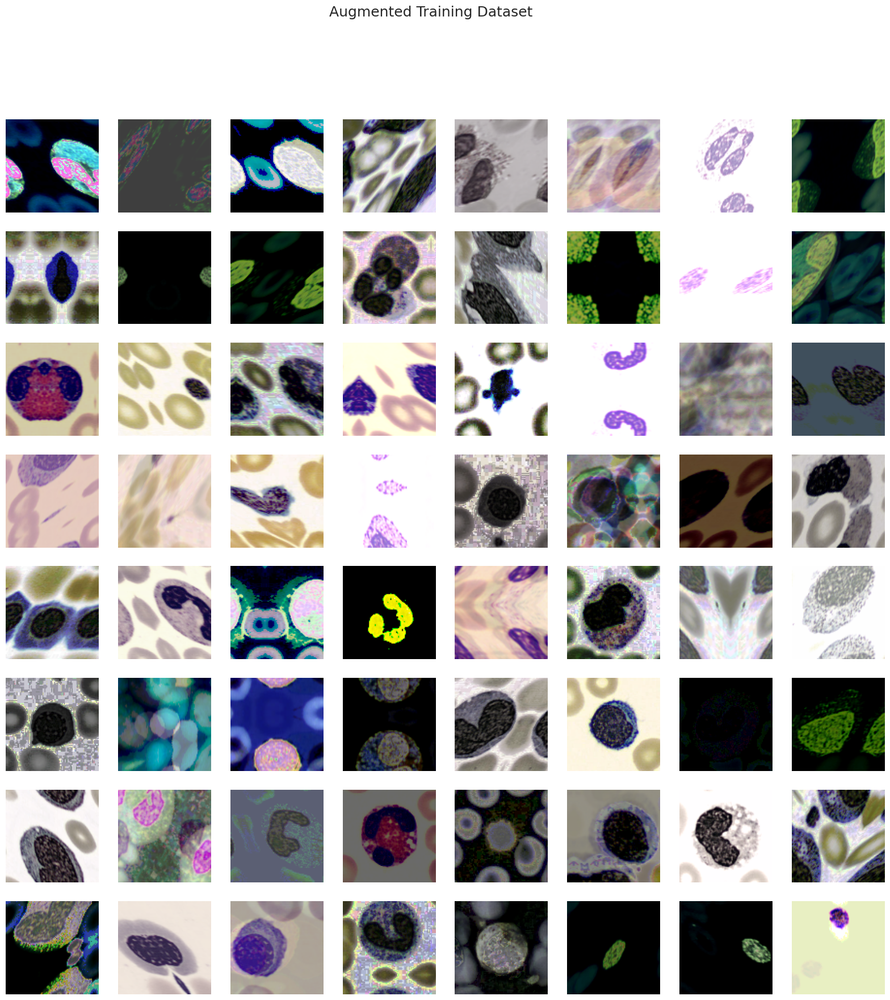

In [12]:
# Randomly pick N samples
def visualize_dataset(dataset, title):
    data_list = list(dataset.as_numpy_iterator())
    num_images_to_plot = 64
    print("training set images :",len(data_list)*batch_size)
    random_samples = random.sample(data_list, num_images_to_plot)

    plt.figure(figsize=(20, 20)).suptitle(title, fontsize=18)
    for i, samples in enumerate(random_samples):
        images = samples[0]
        # Scale the pixel values to 0-255 and convert to uint8
        image_to_display = (images[0] * 255).astype("uint8")
        plt.subplot(8, 8, i + 1)
        plt.imshow(image_to_display)  # Display the scaled image
        plt.axis("off")
    plt.show()

visualize_dataset(train_dataset, "Augmented Training Dataset")

## Train and Save the Model

In [16]:
# Regularisation term
dropout_rate = 0.35

# Print the defined parameters
print("Batch Size:", batch_size)
print("Dropout Rate:", dropout_rate)

Batch Size: 32
Dropout Rate: 0.35


## Transfert Learning: ConveXNetLarge

785596384/785596384 ━━━━━━━━━━━━━━━━━━━━ 27s 0us/step


Model: "convnext_large"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 96, 96, 3) │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ convnext_large_pre… │ (None, 96, 96, 3) │          0 │ input_layer[0][0] │
│ (Normalization)     │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ convnext_large_stem │ (None, 24, 24,    │      9,792 │ convnext_large_p… │
│ (Sequential)        │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ convnext_large_sta… │ (None, 24, 24,    │      9,600 │ convnext_large_s… │
│ (Conv2D)            │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ convnext_large_sta… │ (None, 24, 24,    │        384 │ convnext_large_s… │
│ (LayerNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ convnext_large_sta… │ (None, 24, 24,    │    148,224 │ convnext_large_s… │
│ (Dense)             │ 768)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ convnext_large_sta… │ (None, 24, 24,    │          0 │ convnext_large_s… │
│ (Activation)        │ 768)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ convnext_large_sta… │ (None, 24, 24,    │    147,648 │ convnext_large_s… │
│ (Dense)             │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ convnext_large_sta… │ (None, 24, 24,    │        192 │ convnext_large_s… │
│ (LayerScale)        │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ convnext_large_sta… │ (None, 24, 24,    │          0 │ convnext_large_s… │
│ (Activation)        │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 24, 24,    │          0 │ convnext_large_s… │
│                     │ 192)              │            │ convnext_large_s… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ convnext_large_sta… │ (None, 24, 24,    │      9,600 │ add[0][0]         │
│ (Conv2D)            │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ convnext_large_sta… │ (None, 24, 24,    │        384 │ convnext_large_s… │
│ (LayerNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ convnext_large_sta… │ (None, 24, 24,    │    148,224 │ convnext_large_s… │
│ (Dense)             │ 768)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ convnext_large_sta… │ (None, 24, 24,    │          0 │ convnext_large_s… │
│ (Activation)        │ 768)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ convnext_large_sta… │ (None, 24, 24,    │    147,648 │ convnext_large_s… │
│ (Dense)             │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ convnext_large_sta… │ (None, 24, 24,    │        192 │ convnext_large_s

 Total params: 196,230,336 (748.56 MB)

 Trainable params: 196,230,336 (748.56 MB)

 Non-trainable params: 0 (0.00 B)

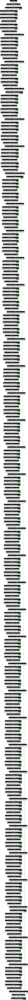

In [14]:
from tensorflow.keras.applications import ConvNeXtLarge

# import the model
# Initialise ConvNeXtXLarge model with pretrained weights, for transfer learning
conv = ConvNeXtLarge(
    include_top=False,
    weights="imagenet",
    input_shape=(96, 96, 3),
    classes=8,
    pooling='avg',
)

# Display a summary of the model architecture
conv.summary(expand_nested=False)

# Display model architecture with layer shapes and trainable parameters
tfk.utils.plot_model(conv, expand_nested=True, show_trainable=True, show_shapes=True, dpi=70)

In [22]:
# Learning rate: step size for updating the model's weights
learning_rate = 0.001
weight_decay = 1e-4

# create the model
# Freeze all layers to use it solely as a feature extractor
conv.trainable = False

def build_model(
    input_shape=X_data.shape[1:],
    output_shape=train_dataset.element_spec[1].shape[1],
    dropout_rate=dropout_rate,
    seed=seed
):
    tf.random.set_seed(seed)

    # Build the neural network layer by layer
    inputs = tfkl.Input(shape=input_shape, name='Input')

    # Pass augmented inputs through the feature extractor
    x = conv(inputs)
    x = tfkl.Dropout(dropout_rate, seed=seed, name='Dropout1')(x)
    x = tfkl.Dense(512, name='dense')(x)
    x = tfkl.BatchNormalization(name='bn')(x)
    x = tfkl.Activation(activation='relu', name='actv')(x)
    x = tfkl.Dropout(dropout_rate, seed=seed, name='Dropout2')(x)
    
    outputs = tfkl.Dense(units=output_shape,activation='softmax',name='softmax', dtype='float32')(x)

    # Connect input and output through the Model class
    model = tfk.Model(inputs=inputs, outputs=outputs, name='CNN')

    # Compile the model
    loss = tfk.losses.CategoricalFocalCrossentropy()
    optimizer = tfk.optimizers.AdamW(learning_rate=learning_rate,weight_decay=weight_decay)
    metrics=['accuracy']
    model.compile(loss=loss, optimizer=optimizer, metrics=metrics)

    # Return the model
    return model

Model: "CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━┓
┃ Layer (type)                ┃ Output Shape          ┃    Param # ┃ Trai… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━┩
│ Input (InputLayer)          │ (None, 96, 96, 3)     │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ convnext_large (Functional) │ (None, 1536)          │ 196,230,3… │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ Dropout1 (Dropout)          │ (None, 1536)          │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense (Dense)               │ (None, 512)           │    786,944 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ bn (BatchNormalization)     │ (None, 512)           │      2,048 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ actv (Activation)           │ (None, 512)           │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ Dropout2 (Dropout)          │ (None, 512)           │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ softmax (Dense)             │ (None, 8)             │      4,104 │   Y   │
└─────────────────────────────┴───────────────────────┴────────────┴───────┘

 Total params: 197,023,432 (751.58 MB)

 Trainable params: 792,072 (3.02 MB)

 Non-trainable params: 196,231,360 (748.56 MB)

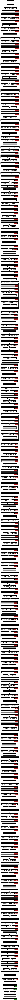

In [23]:
# Build the model
# Build the model with specified input and output shapes

model = build_model()

# Display a summary of the model architecture
model.summary(expand_nested=False, show_trainable=True)

# Plot the model architecture
tfk.utils.plot_model(model, expand_nested=True, show_trainable=True, show_shapes=True, dpi=70)

In [24]:
patience = 15
epochs = 400
# Define early stopping callback
early_stopping = tfk.callbacks.EarlyStopping(
    monitor='val_accuracy',
    patience=patience,
    mode='max',
    restore_best_weights=True)

# defining callbacks
callbacks = [early_stopping]

print("early stopping patience: ", patience)

early stopping patience:  15


In [19]:
history = model.fit(
    train_dataset,
    epochs=epochs,
    validation_data=val_dataset,
    callbacks=callbacks,
).history

# Calculate and print the final validation accuracy
final_val_accuracy = round(max(history['val_accuracy'])* 100, 2)
print(f'Final validation accuracy: {final_val_accuracy}%')

# Save the trained model to a file with the accuracy included in the filename
model_filename = '/kaggle/working/ConvNeXtLarge'+str(final_val_accuracy)+'.keras'
model.save(model_filename)

print('Final training accuracy: ', round(max(history['accuracy'])*100,2))

Epoch 1/400


I0000 00:00:1732356590.133863     101 service.cc:146] XLA service 0x7c470c0119a0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1732356590.133938     101 service.cc:154]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1732356590.133945     101 service.cc:154]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5


  1/240 ━━━━━━━━━━━━━━━━━━━━ 1:55:35 29s/step - accuracy: 0.1562 - loss: 0.7334

I0000 00:00:1732356598.931532     101 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


240/240 ━━━━━━━━━━━━━━━━━━━━ 153s 519ms/step - accuracy: 0.2434 - loss: 0.5088 - val_accuracy: 0.6557 - val_loss: 0.1679
Epoch 2/400
240/240 ━━━━━━━━━━━━━━━━━━━━ 116s 465ms/step - accuracy: 0.3409 - loss: 0.3436 - val_accuracy: 0.7382 - val_loss: 0.1400
Epoch 3/400
240/240 ━━━━━━━━━━━━━━━━━━━━ 116s 466ms/step - accuracy: 0.3504 - loss: 0.3264 - val_accuracy: 0.7351 - val_loss: 0.1356
Epoch 4/400
240/240 ━━━━━━━━━━━━━━━━━━━━ 113s 454ms/step - accuracy: 0.3773 - loss: 0.2976 - val_accuracy: 0.7205 - val_loss: 0.1370
Epoch 5/400
240/240 ━━━━━━━━━━━━━━━━━━━━ 114s 458ms/step - accuracy: 0.3733 - loss: 0.2927 - val_accuracy: 0.7106 - val_loss: 0.1475
Epoch 6/400
240/240 ━━━━━━━━━━━━━━━━━━━━ 122s 491ms/step - accuracy: 0.3854 - loss: 0.2897 - val_accuracy: 0.7618 - val_loss: 0.1281
Epoch 7/400
240/240 ━━━━━━━━━━━━━━━━━━━━ 117s 470ms/step - accuracy: 0.3815 - loss: 0.2888 - val_accuracy: 0.7456 - val_loss: 0.1363
Epoch 8/400
240/240 ━━━━━━━━━━━━━━━━━━━━ 114s 458ms/step - accuracy: 0.4032 - los

## Show accurancy and loss

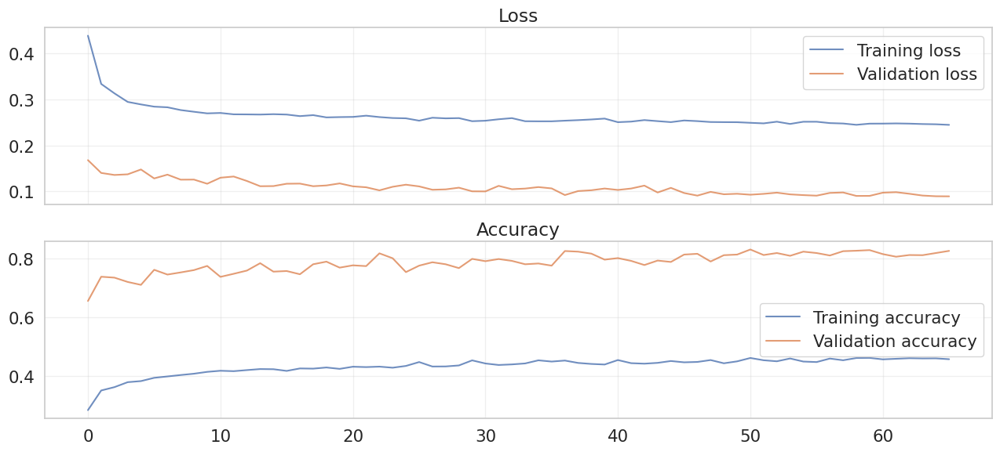

In [20]:
# Create a figure with two vertically stacked subplots
fig, (ax1, ax2) = plt.subplots(nrows=2, ncols=1, figsize=(15, 6), sharex=True)

# Plot training and validation loss
ax1.plot(history['loss'], label='Training loss', alpha=.8)
ax1.plot(history['val_loss'], label='Validation loss', alpha=.8)
ax1.set_title('Loss')
ax1.legend()
ax1.grid(alpha=.3)

# Plot training and validation accuracy
ax2.plot(history['accuracy'], label='Training accuracy', alpha=.8)
ax2.plot(history['val_accuracy'], label='Validation accuracy', alpha=.8)
ax2.set_title('Accuracy')
ax2.legend()
ax2.grid(alpha=.3)

# Adjust the layout and display the plot
plt.tight_layout()
plt.subplots_adjust(right=0.85)
plt.show()


# Delete the model to free up resources
del model

## Fine Tuning

Model: "CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ Input (InputLayer)              │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ convnext_large (Functional)     │ (None, 1536)           │   196,230,336 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Dropout1 (Dropout)              │ (None, 1536)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │       786,944 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bn (BatchNormalization)         │ (None, 512)            │         2,048 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ actv (Activation)               │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Dropout2 (Dropout)              │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ softmax (Dense)                 │ (None, 8)              │         4,104 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 198,607,578 (757.63 MB)

 Trainable params: 792,072 (3.02 MB)

 Non-trainable params: 196,231,360 (748.56 MB)

 Optimizer params: 1,584,146 (6.04 MB)

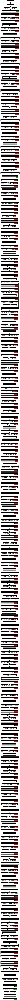

In [25]:
# Re-load the model after transfer learning
ft_model = tfk.models.load_model('/kaggle/working/ConvNeXtLarge83.07.keras') 

# Display a summary of the model architecture
ft_model.summary(expand_nested=False)

# Display model architecture with layer shapes and trainable parameters
tfk.utils.plot_model(ft_model, expand_nested=True, show_trainable=True, show_shapes=True, dpi=70)

Model: "CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ Input (InputLayer)              │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ convnext_large (Functional)     │ (None, 1536)           │   196,230,336 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Dropout1 (Dropout)              │ (None, 1536)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │       786,944 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bn (BatchNormalization)         │ (None, 512)            │         2,048 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ actv (Activation)               │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Dropout2 (Dropout)              │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ softmax (Dense)                 │ (None, 8)              │         4,104 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 198,607,578 (757.63 MB)

 Trainable params: 176,689,416 (674.02 MB)

 Non-trainable params: 20,334,016 (77.57 MB)

 Optimizer params: 1,584,146 (6.04 MB)

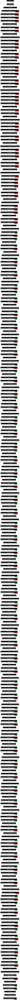

In [26]:
# Set the model layers as trainable
ft_model.get_layer('convnext_large').trainable = True

# Set all layers as non-trainable
for layer in ft_model.get_layer('convnext_large').layers:
    layer.trainable = False

# Unfreeze the last 200 layers (only considering Conv2D,DepthwiseConv2D,Dense)
for layer in ft_model.get_layer('convnext_large').layers[-200:]: 
    if isinstance(layer, tf.keras.layers.Conv2D) or isinstance(layer, tf.keras.layers.DepthwiseConv2D) or isinstance(layer, tf.keras.layers.Dense):
        layer.trainable = True

# Display a summary of the model architecture
ft_model.summary(expand_nested=False)

# Display model architecture with layer shapes and trainable parameters
tfk.utils.plot_model(ft_model, expand_nested=True, show_trainable=True, show_shapes=True, dpi=70)

0.0001 1.0000007593893327e-05


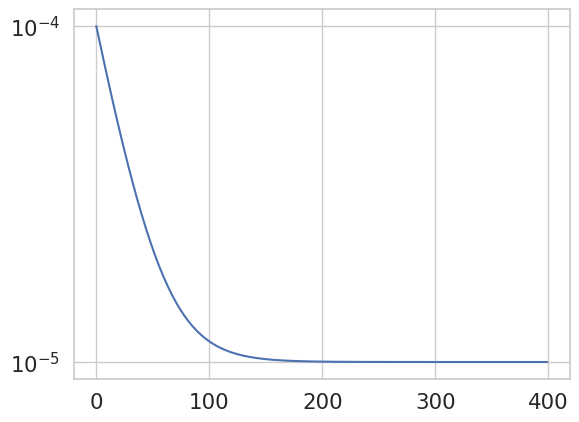

In [39]:
epochs = 400
initial_lr=0.0001
min_lr = 1e-5
weight_decay = 1e-4

def dynamic_learning_rate(
    epoch=epochs,
    start_lr=initial_lr,
    min_lr=min_lr,
    max_lr=initial_lr,
    rampup_epochs=0,
    sustain_epochs=0,
    exp_decay = 0.96,
):
    def lr(epoch, start_lr, min_lr, max_lr, rampup_epochs, sustain_epochs, exp_decay):
        if epoch < rampup_epochs:
            lr = (max_lr - start_lr)/rampup_epochs * epoch + start_lr
        elif epoch < rampup_epochs + sustain_epochs:
            lr = max_lr
        else:
            lr = (max_lr - min_lr) * exp_decay**(epoch-rampup_epochs-sustain_epochs) + min_lr
        return lr

    return lr(epoch, start_lr, min_lr, max_lr, rampup_epochs, sustain_epochs, exp_decay)

rng = [i for i in range(epochs)]
y = [dynamic_learning_rate(x) for x in rng]
plt.semilogy(rng, [dynamic_learning_rate(x) for x in rng])
print(y[0], y[-1])

In [40]:
patience = 20
# Define early stopping callback
early_stopping = tfk.callbacks.EarlyStopping(
    monitor='val_accuracy',
    patience=patience,
    mode='max',
    restore_best_weights=True)

# A callback to change the learning rate dynamically as specified by the function dynamic_learning_rate
lr_callback = tf.keras.callbacks.LearningRateScheduler(
    lambda epoch: dynamic_learning_rate(epoch),
    verbose=True
)

callbacks = [early_stopping,lr_callback]

In [41]:
# Compile the model
loss = tfk.losses.CategoricalFocalCrossentropy()
optimizer = tfk.optimizers.AdamW(learning_rate=initial_lr,weight_decay=weight_decay)
metrics=['accuracy']
ft_model.compile(loss=loss, optimizer=optimizer, metrics=metrics)

# train
history = ft_model.fit(
    train_dataset,
    epochs=epochs,
    validation_data=val_dataset,
    callbacks=callbacks,
).history

# Calculate and print the final validation accuracy
final_val_accuracy = round(max(history['val_accuracy'])* 100, 2)
print(f'Final validation accuracy: {final_val_accuracy}%')

# Save the trained model to a file with the accuracy included in the filename
modelft_filename = '/kaggle/working/ConvNeXtLargeFT'+str(final_val_accuracy)+'.keras'
ft_model.save(modelft_filename)

print('Final training accuracy: ', round(max(history['accuracy'])*100,2))


Epoch 1: LearningRateScheduler setting learning rate to 0.0001.
Epoch 1/400
240/240 ━━━━━━━━━━━━━━━━━━━━ 232s 770ms/step - accuracy: 0.5208 - loss: 0.2163 - val_accuracy: 0.8438 - val_loss: 0.0608 - learning_rate: 1.0000e-04

Epoch 2: LearningRateScheduler setting learning rate to 9.64e-05.
Epoch 2/400
240/240 ━━━━━━━━━━━━━━━━━━━━ 169s 693ms/step - accuracy: 0.6010 - loss: 0.1777 - val_accuracy: 0.8788 - val_loss: 0.0411 - learning_rate: 9.6400e-05

Epoch 3: LearningRateScheduler setting learning rate to 9.2944e-05.
Epoch 3/400
240/240 ━━━━━━━━━━━━━━━━━━━━ 168s 687ms/step - accuracy: 0.6265 - loss: 0.1621 - val_accuracy: 0.8689 - val_loss: 0.0411 - learning_rate: 9.2944e-05

Epoch 4: LearningRateScheduler setting learning rate to 8.962623999999999e-05.
Epoch 4/400
240/240 ━━━━━━━━━━━━━━━━━━━━ 171s 698ms/step - accuracy: 0.6581 - loss: 0.1460 - val_accuracy: 0.9133 - val_loss: 0.0267 - learning_rate: 8.9626e-05

Epoch 5: LearningRateScheduler setting learning rate to 8.644119039999999e

In [ ]:
# Save the trained model to a file with the accuracy included in the filename
modelft_filename = '/kaggle/working/ConvNeXtLargeFT'+str(final_val_accuracy)+'.keras'
ft_model.save(modelft_filename)

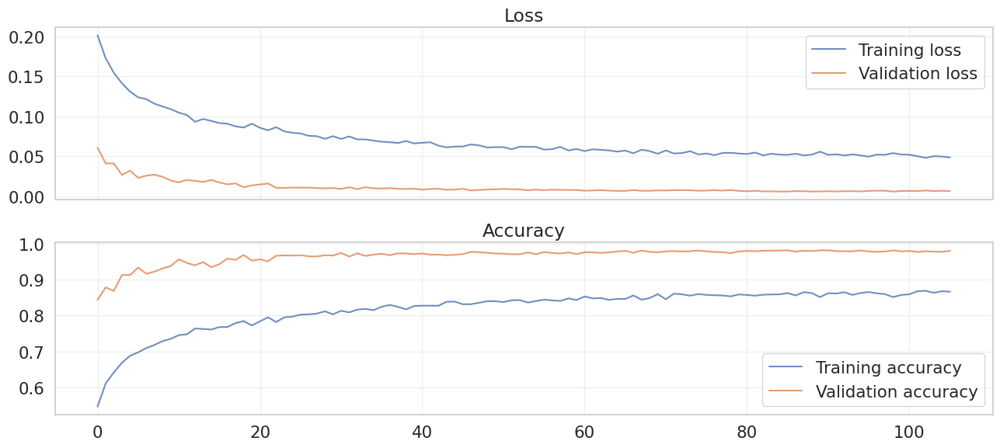

In [42]:
# Create a figure with two vertically stacked subplots
fig, (ax1, ax2) = plt.subplots(nrows=2, ncols=1, figsize=(15, 6), sharex=True)

# Plot training and validation loss
ax1.plot(history['loss'], label='Training loss', alpha=.8)
ax1.plot(history['val_loss'], label='Validation loss', alpha=.8)
ax1.set_title('Loss')
ax1.legend()
ax1.grid(alpha=.3)

# Plot training and validation accuracy
ax2.plot(history['accuracy'], label='Training accuracy', alpha=.8)
ax2.plot(history['val_accuracy'], label='Validation accuracy', alpha=.8)
ax2.set_title('Accuracy')
ax2.legend()
ax2.grid(alpha=.3)

# Adjust the layout and display the plot
plt.tight_layout()
plt.subplots_adjust(right=0.85)
plt.show()


# Delete the model to free up resources
del ft_model

## Test the model

True classes shape: (2392,)
Predicted classes shape: (2392,)
Accuracy score over the test set: 0.9837
Precision score over the test set: 0.984
Recall score over the test set: 0.9837
F1 score over the test set: 0.9837


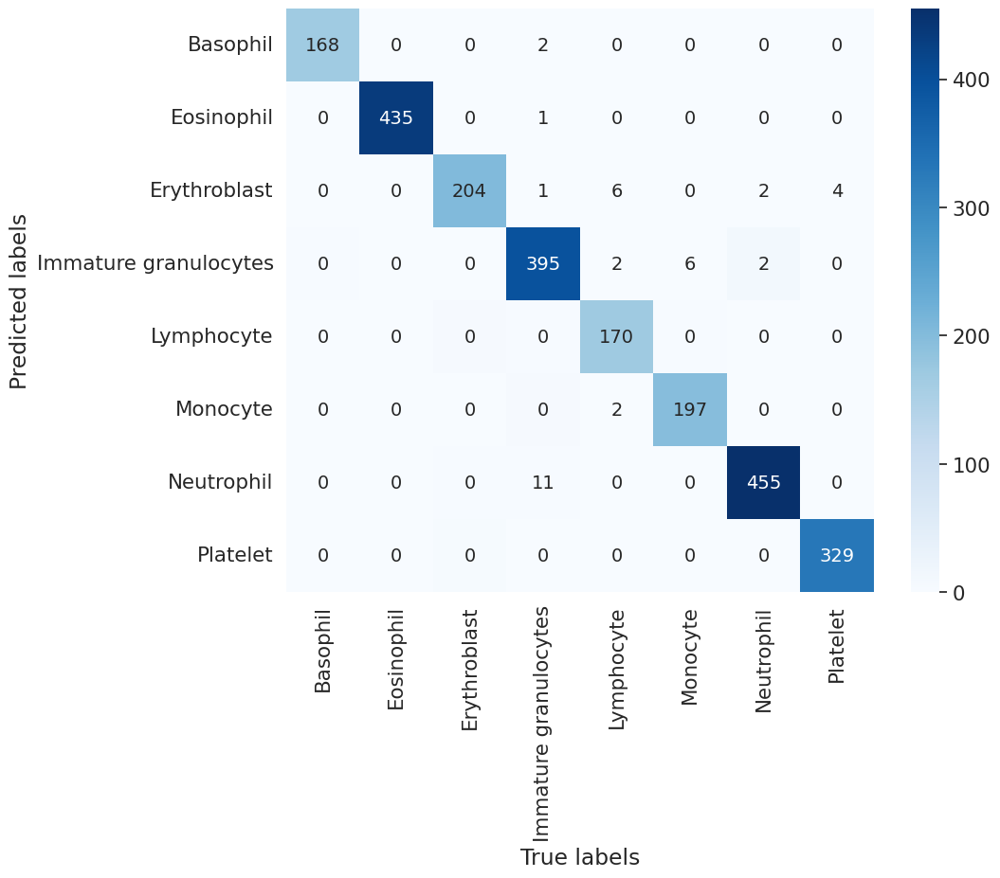

In [43]:
# load the model
model = tfk.models.load_model('/kaggle/working/ConvNeXtLargeFT98.22.keras')

# Predict labels for the entire test set
predictions = model.predict(X_test, verbose=0)

# Convert predictions to class labels
pred_classes = np.argmax(predictions, axis=-1)

# Extract ground truth classes
true_classes = np.argmax(y_test, axis=-1)

print("True classes shape:", true_classes.shape)
print("Predicted classes shape:", pred_classes.shape)

# Calculate and display test set accuracy
accuracy = accuracy_score(true_classes, pred_classes)
print(f'Accuracy score over the test set: {round(accuracy, 4)}')

# Calculate and display test set precision
precision = precision_score(true_classes, pred_classes, average='weighted')
print(f'Precision score over the test set: {round(precision, 4)}')

# Calculate and display test set recall
recall = recall_score(true_classes, pred_classes, average='weighted')
print(f'Recall score over the test set: {round(recall, 4)}')

# Calculate and display test set F1 score
f1 = f1_score(true_classes, pred_classes, average='weighted')
print(f'F1 score over the test set: {round(f1, 4)}')

# Compute the confusion matrix
cm = confusion_matrix(true_classes, pred_classes)

# Combine numbers and percentages into a single string for annotation
annot = np.array([f"{num}" for num in cm.flatten()]).reshape(cm.shape)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm.T, annot=annot, fmt='', xticklabels=list(labels.values()), yticklabels=list(labels.values()), cmap='Blues')
plt.xlabel('True labels')
plt.ylabel('Predicted labels')
plt.show()

## Zip the file

In [44]:
%%writefile model.py
import numpy as np
import tensorflow as tf
from tensorflow import keras as tfk
from tensorflow.keras import layers as tfkl

class Model:
    def __init__(self):
        self.neural_network = tfk.models.load_model('weights.keras')

    def predict(self, X):
        preds = self.neural_network.predict(X)
        if len(preds.shape) == 2:
            preds = np.argmax(preds, axis=1)
        return preds

Overwriting model.py


In [45]:
from datetime import datetime
filename = f'submission_{datetime.now().strftime("%y%m%d_%H%M%S")}.zip'

# Create a zip file and save the model and script in the output folder
import zipfile
with zipfile.ZipFile(f'/kaggle/working/{filename}', 'w') as zipf:
    zipf.write('model.py')
    zipf.write('/kaggle/working/ConvNeXtLargeFT98.22.keras', 'weights.keras')  # Renaming the model file